<a href="https://colab.research.google.com/github/mohigeo33/urban_expansion/blob/main/UrbanAreaExpansionInChawaRampav_colab.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#### Import the required packages

In [1]:
# !pip install geemap geopandas rasterio

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 23.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 55.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.0/20.0 MB 72.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 65.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.6/98.6 kB 10.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 130.5/130.5 kB 12.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.7/3.7 MB 94.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 63.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 98.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.0/16.0 MB 53.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.7/7.7 MB 71.4 

In [2]:
# loading necessary libraries
import os
import glob
import sys
import ee
import geemap
import geopandas as gpd
import pandas as pd
from tqdm import tqdm
import requests
from skimage.io import imread
import matplotlib.pyplot as plt
# from matplotlib import pyplot

import numpy as np
import rasterio
from rasterio.plot import show
import fiona

# from utils import *

#### Authenticate and initialize the google earth engine server

In [3]:
ee.Authenticate()
ee.Initialize()

To authorize access needed by Earth Engine, open the following URL in a web browser and follow the instructions. If the web browser does not start automatically, please manually browse the URL below.

    https://code.earthengine.google.com/client-auth?scopes=https%3A//www.googleapis.com/auth/earthengine%20https%3A//www.googleapis.com/auth/devstorage.full_control&request_id=x8EsX6ndGyjCdEFXAMvBGZzCG97bjGWf_pwLdjRQ1_E&tc=KytJ-86DG3DgKzFgnoe9Cer7VnJx9YyJzRwGohz9qs0&cc=UbgNmI6B7Dve2xxr2Jvc_qxq6vlv7GhwsZxLbfMFRrc

The authorization workflow will generate a code, which you should paste in the box below.
Enter verification code: 4/1AbUR2VMO8Rc79ZY2EdID8J4iQJg2OBdPNKEWUpSj8VyhFKg8FLxD93CXk3k

Successfully saved authorization token.


#### User Inputs

In [4]:
# Study period
from_year = 2013
to_year = 2021
from_month = 1
to_month = 12
maximum_cloud = 10# in percentage

# AOI
# roi =  "./aoi3/aoi3.shp" # insert input here
# aoi = geemap.shp_to_ee(roi)
aoi = ee.FeatureCollection('projects/urban-area-expansion/assets/Chbar_Ampov_Boundary')
validationPoints = ee.FeatureCollection('projects/urban-area-expansion/assets/ValPointswithXYCoords')

In [5]:
# Visualise the AOI boundary
Map = geemap.Map()
Map.addLayer(aoi, {}, 'AOI')
Map.addLayer(validationPoints, {}, 'validationPoints')
Map.centerObject(aoi, zoom=12)
Map

Map(center=[11.506937435090014, 104.98769611299336], controls=(WidgetControl(options=['position', 'transparent…

#### Defining the required functions

In [6]:
# For Pre processing

# Cloud masking for Surface Reflectance Products (Nill et. al., 2019)
def fctn_cloud(img):
    cloudShadowBitMask = ee.Number(2).pow(3).int()
    cloudsBitMask = ee.Number(2).pow(5).int()
    snowBitMask = ee.Number(2).pow(4).int()
    qa = img.select('pixel_qa')
    mask = qa.bitwiseAnd(cloudShadowBitMask).eq(0).And(qa.bitwiseAnd(cloudsBitMask).eq(0)).And(
        qa.bitwiseAnd(snowBitMask).eq(0))
    return img.updateMask(mask)


def fctn_bndscale_ls8(img):
    bands = ['B2', 'B3', 'B4', 'B5', 'B6', 'B7']
    new_bands = ['blue', 'green', 'red', 'nir', 'swir1', 'swir2']
    visnirswir = img.select(bands).rename(new_bands)
    return visnirswir.copyProperties(img, ['system:time_start'])

#clipping
def fctn_clip(img):
    clip_img = img.clip(aoi)
    return clip_img 

In [7]:
# For Feature creation

# NDBI
def fctn_ndbi(img):
    ndbi = img.normalizedDifference(['swir1', 'nir']).rename('NDBI')
    return img.addBands(ndbi)       

def fctn_ndwi(img):
    ndwi = img.normalizedDifference(['green', 'swir1']).rename('NDWI')
    return img.addBands(ndwi)

# NDVI
def fctn_ndvi(img):
    ndvi = img.normalizedDifference(['nir', 'red']).rename('NDVI')
    return img.addBands(ndvi)

# SAVI
def fctn_savi(img):
    l = ee.Number(0.5)
    savi = img.expression('((nir - red) / (nir + red + l)) * (1+l)',{
            'nir': img.select('nir'),
            'red': img.select('red'),
            'l': l}).rename('SAVI')
    return img.addBands(savi)

def fctn_ibi(img):
    const = ee.Number(2)
    ibi = img.expression(
        '(((const * swir1) / (swir1 + nir))-((nir / (nir + red)) + (green / (green + swir1))))   / (((const * swir1) / (swir1 + nir))+((nir / (nir + red)) + (green / (green + swir1))))',           {
            'swir1': img.select('swir1'),
            'nir': img.select('nir'),
            'red': img.select('red'),
            'green': img.select('green'),
            'const': const}).rename('IBI')
    return img.addBands(ibi)

In [8]:
# Utilities 
def fctn_downloadImageCollection(imagecollection, region, foldername):
    imagecollection = ee.ImageCollection(imagecollection)

    region = ee.FeatureCollection(region)
    
    ImageCollectionFeaturesMeta = imagecollection.getInfo()['features']
    imagecollection_size =  len(ImageCollectionFeaturesMeta) #imagecollection.size().getInfo()
    
    imagecollection_list = imagecollection.toList(imagecollection_size)
    
    for i in tqdm(range(0,imagecollection_size)):
        image = ee.Image(imagecollection_list.get(i))
        image_id = ImageCollectionFeaturesMeta[i]['id'].split('/')[-1] #image.id().getInfo()
        
        image_download_url = image.getDownloadUrl({
            'region': region.geometry().bounds().getInfo()['coordinates'], #region.geometry()
            'scale': 30,
            'format': 'GEO_TIFF'})
        
        response = requests.get(image_download_url)
        filename = "./"+str(foldername)+"/"+str(image_id)+".tiff"
        
        os.makedirs(os.path.dirname(filename), exist_ok=True)
        with open(filename, 'wb') as fd:
            fd.write(response.content)        
    return


def fctn_showAllTiffsfroPath(folder_path):
    filenames = glob.glob(folder_path + '*.tiff')
    num_files = len(filenames)
    num_rows = (num_files + 2) // 3

    fig, axs = plt.subplots(num_rows, 3, figsize=(12, 4*num_rows))

    for idx, filename in enumerate(filenames):
        rowidx = idx // 3
        colidx = idx % 3

        Allbands = rasterio.open(filename, 'r')

        ax = axs[rowidx, colidx]
        show((Allbands, 1), ax=ax, cmap='turbo')
        ax.set_title(filename.replace('\\','/'))

        norm = plt.Normalize(vmin=Allbands.read(1).min(), vmax=Allbands.read(1).max())
        sm = plt.cm.ScalarMappable(cmap='turbo', norm=norm)
        cbar = fig.colorbar(sm, ax=ax, shrink=0.5, pad=0.05, aspect=10)
        Allbands.close()

    plt.tight_layout()
    plt.show()
    return


def convertIBItoBinary(folder_path, output_path):
    filepaths = glob.glob(folder_path + '*.tiff')
    num_files = len(filepaths)
    
    for i in range(0, num_files):
        filepath = filepaths[i].replace('\\','/')
        filename = filepath.split('/')[-1].replace('.','_Binary.')
        
        with rasterio.open(filepath) as f:
            upadated_file_data = f.read(1)
          # replace all the values less than 0
            upadated_file_data[upadated_file_data == 0] = 0
            upadated_file_data[upadated_file_data < 0.018] = -1
            upadated_file_data[upadated_file_data >= 0.018] = 1
                
                
            updatedfile_meta  = f.meta.copy()
            os.makedirs(os.path.dirname(outpath+filename), exist_ok=True)
            with rasterio.open(outpath+filename, 'w', **updatedfile_meta) as dst:
                    dst.write_band(1, upadated_file_data.astype(rasterio.int16))            
    return 

#### Data acquisition

In [9]:
# Landsat 8
coll_ls8_sr = ee.ImageCollection('LANDSAT/LC08/C01/T1_SR')\
    .filterBounds(aoi)\
    .filter(ee.Filter.calendarRange(from_year,to_year,'year'))\
    .filter(ee.Filter.calendarRange(from_month,to_month,'month'))\
    .filter(ee.Filter.lt('CLOUD_COVER_LAND', maximum_cloud))\
    .map(fctn_cloud)

print("Total LS 8 collection SR: ",coll_ls8_sr.size().getInfo())

Total LS 8 collection SR:  30


#### Data pre-processing

In [10]:
coll_ls8_sr = coll_ls8_sr.map(lambda img: img.multiply(0.0001).copyProperties(img, img.propertyNames())) # Radiometric calibration
coll_ls8_sr = coll_ls8_sr.map(fctn_bndscale_ls8) #renaming bands
merged_coll = coll_ls8_sr.sort('system:time_start') #sorting the images according to time

#### Output feature creation

In [11]:
dataset = merged_coll
dataset = dataset.map(fctn_ndbi) # Calculating and adding NDBI to dataset
dataset = dataset.map(fctn_ndwi)  # Calculating and adding NDWI to dataset
dataset = dataset.map(fctn_savi) # Calculating and adding SAVI to dataset
dataset = dataset.map(fctn_ibi) # Calculating and adding IBI to dataset
dataset = dataset.map(fctn_ndvi) # Calculating and adding NDVI to dataset

In [12]:
# Separating all new created features
allNDBI = dataset.map(lambda image: image.select('NDBI')) 
allNDWI = dataset.map(lambda image: image.select('NDWI'))
allSAVI = dataset.map(lambda image: image.select('SAVI'))
allIBI = dataset.map(lambda image: image.select('IBI'))
allNDVI = dataset.map(lambda image: image.select('NDVI'))

# Downloading the newly created features bandwise
print('Downloading allNDBI')
fctn_downloadImageCollection(allNDBI,aoi,'allNDBI') 
print('Downloading allNDWI')
fctn_downloadImageCollection(allNDWI,aoi,'allNDWI')
print('Downloading allSAVI')
fctn_downloadImageCollection(allSAVI,aoi,'allSAVI')
print('Downloading allIBI')
fctn_downloadImageCollection(allIBI ,aoi,'allIBI')
print('Downloading allNDVI')
fctn_downloadImageCollection(allNDVI,aoi,'allNDVI')

100%|██████████| 30/30 [00:43<00:00,  1.44s/it]


100%|██████████| 30/30 [00:39<00:00,  1.32s/it]


100%|██████████| 30/30 [00:41<00:00,  1.39s/it]


100%|██████████| 30/30 [00:44<00:00,  1.47s/it]


100%|██████████| 30/30 [00:36<00:00,  1.23s/it]


In [13]:
# Get yearly one dataset
years = range(from_year, to_year + 1)

yearlydatasetNDBI = [] #this variable contains a single image from each year
yearlydatasetNDWI = []
yearlydatasetSAVI = []
yearlydatasetIBI = []
yearlydatasetNDVI = []

for year in years:
    start = ee.Date.fromYMD(year, 1, 1)
    end = ee.Date.fromYMD(year, 12, 31)
    
    thisyrNDBI = allNDVI.filterDate(start, end).first()
    thisyrNDWI = allNDWI.filterDate(start, end).first()
    thisyrSAVI = allSAVI.filterDate(start, end).first()
    thisyrIBI = allIBI.filterDate(start, end).first()
    thisyrNDVI = allNDVI.filterDate(start, end).first()
    
    yearlydatasetNDBI.append(thisyrNDBI) 
    yearlydatasetNDWI.append(thisyrNDWI)
    yearlydatasetSAVI.append(thisyrSAVI)
    yearlydatasetIBI.append(thisyrIBI)
    yearlydatasetNDVI.append(thisyrNDVI)
    
yearlydatasetNDBI = ee.ImageCollection.fromImages(yearlydatasetNDBI)
yearlydatasetNDWI = ee.ImageCollection.fromImages(yearlydatasetNDWI)
yearlydatasetSAVI = ee.ImageCollection.fromImages(yearlydatasetSAVI)
yearlydatasetIBI = ee.ImageCollection.fromImages(yearlydatasetIBI)
yearlydatasetNDVI = ee.ImageCollection.fromImages(yearlydatasetNDVI)

fctn_downloadImageCollection(yearlydatasetNDBI, aoi, 'allNDBI/OnePerYear')
fctn_downloadImageCollection(yearlydatasetNDWI, aoi, 'allNDWI/OnePerYear')
fctn_downloadImageCollection(yearlydatasetSAVI, aoi, 'allSAVI/OnePerYear')
fctn_downloadImageCollection(yearlydatasetIBI, aoi, 'allIBI/OnePerYear')
fctn_downloadImageCollection(yearlydatasetNDVI, aoi, 'allNDVI/OnePerYear')

100%|██████████| 8/8 [00:13<00:00,  1.65s/it]


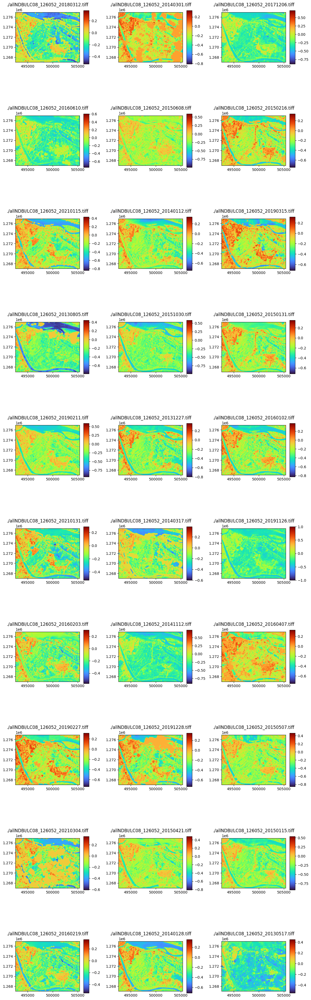

In [14]:
#Showing all NDBI
dirNDBI = './allNDBI/'
fctn_showAllTiffsfroPath(dirNDBI)

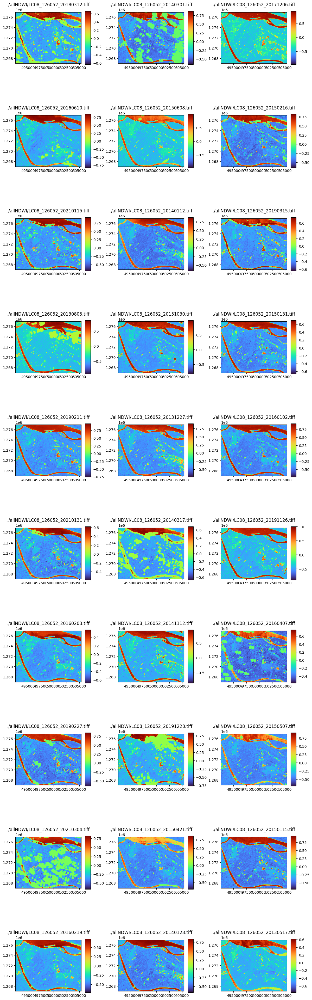

In [15]:
#Showing all NDWI
dirNDWI = './allNDWI/'
fctn_showAllTiffsfroPath(dirNDWI)

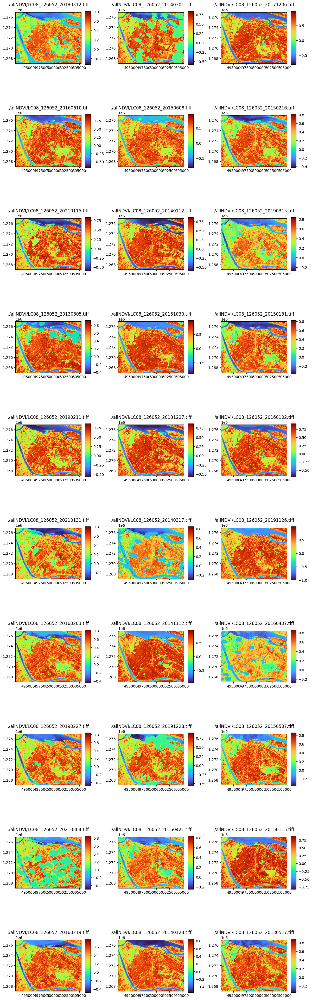

In [16]:
#Showing all NDVI
dirNDVI = './allNDVI/'
fctn_showAllTiffsfroPath(dirNDVI)

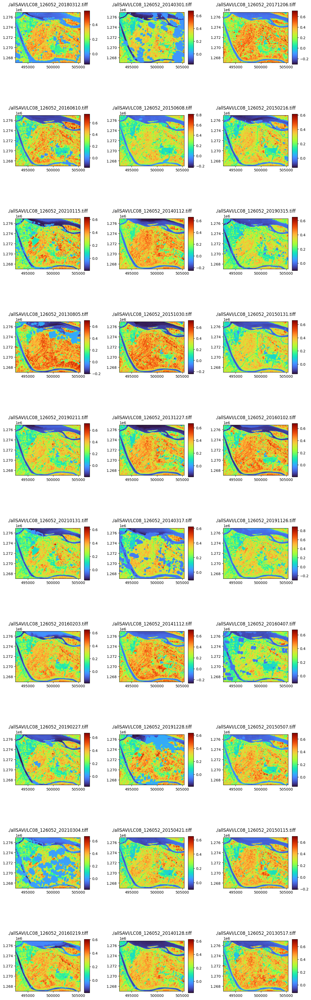

In [17]:
#Showing all SAVI
dirSAVI = './allSAVI/'
fctn_showAllTiffsfroPath(dirSAVI)

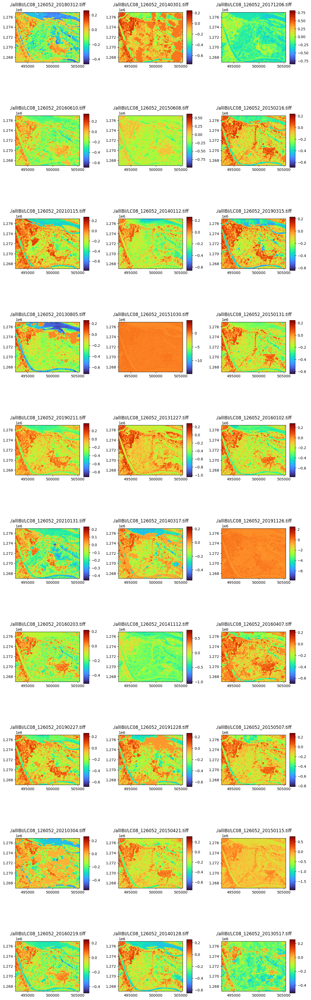

In [18]:
#Showing all IBI
dirIBI = './allIBI/'
fctn_showAllTiffsfroPath(dirIBI)

#### Convert the IBI to binary(Builtup/Non-builtup) and save the  as tiff

In [19]:
outpath = './allIBI/Binary/'
convertIBItoBinary(dirIBI,outpath)

#### Post processing

In [20]:
# Creating the dataset for ground validation

validationPoints_gdf = geemap.ee_to_gdf(validationPoints)
ibi_one_per_yr_folderpath = './allIBI/OnePerYear/'
ibi_one_per_yr_file_paths = glob.glob(ibi_one_per_yr_folderpath + '*.tiff')
num_files = len(ibi_one_per_yr_file_paths)


for i in range(0, num_files):
    filepath = ibi_one_per_yr_file_paths[i].replace('\\','/')
    yr = filepath.split('_')[-1][:4]

    with rasterio.open(filepath) as src:
        file_data = src.read(1)
        file_transform = src.transform
    
    # Get the pixel values for each point
    yr_pixel_values = []
    builup_statuses = []

    for i, point in validationPoints_gdf.iterrows():
        point_row, point_col = rasterio.transform.rowcol(file_transform, point.x, point.y)
        point_pixel_value = round(file_data[point_row, point_col],5)
        yr_pixel_values.append(point_pixel_value)
        
        if point_pixel_value < 0.018:
            builtup_status = 0 # 0 : Non Builtup
            
        elif point_pixel_value >= 0.018:
            builtup_status = 1 # 1: Builtup
        builup_statuses.append(builtup_status)
        
    validationPoints_gdf[yr]=yr_pixel_values
    validationPoints_gdf[str(yr)+'T']=builup_statuses

In [21]:
validationPoints_gdf.head(3)

,geometry,rand_point,x,y,2018,2018T,2017,2017T,2021,2021T,2014,2014T,2019,2019T,2016,2016T,2015,2015T,2013,2013T
0,POINT (104.95585 11.49783),1,495185.806143,1.271026e+06,-0.09189,0,-0.20527,0,-0.19942,0,-0.12489,0,-0.12572,0,-0.13360,0,-0.11070,0,-0.19218,0
1,POINT (104.97274 11.50314),2,497026.769454,1.271613e+06,-0.12313,0,-0.23631,0,-0.17796,0,-0.20062,0,-0.10654,0,-0.18903,0,-0.13333,0,-0.22354,0
2,POINT (104.96398 11.47579),3,496071.528397,1.268588e+06,-0.20253,0,-0.28432,0,-0.21506,0,-0.22786,0,-0.22711,0,-0.29762,0,-0.23484,0,-0.26814,0


In [22]:
validationPoints_path = './validationPointsForGroundValidation/'
os.makedirs(os.path.dirname(validationPoints_path), exist_ok=True)
validationPoints_gdf.to_file(validationPoints_path+'validationPointsWithIBI.shp', crs = "EPSG:4326") # GEE stores fc in 4326

In [23]:
# creating a dataframe for indices values for validation points to understand the coorelation between indices
    # for this one representative image (from 2017) is considered 
    

pixeldatafarame = pd.DataFrame(columns=['PointID','NDBI','NDWI','IBI','NDVI'])

# Load the selected image tiff file for all the indices folders
rasterfile_ibi = './allIBI/OnePerYear/LC08_126052_20171206.tiff'
rasterfile_ndbi = './allNDBI/OnePerYear/LC08_126052_20171206.tiff'
rasterfile_ndwi = './allNDWI/OnePerYear/LC08_126052_20171206.tiff'
rasterfile_ndvi = './allNDVI/OnePerYear/LC08_126052_20171206.tiff'

# Load the raster file 

#ibi
with rasterio.open(rasterfile_ibi) as src:
    file_data_ibi = src.read(1)
    transform_ibi = src.transform
    
# ndbi
with rasterio.open(rasterfile_ndbi) as src:
    file_data_ndbi = src.read(1)
    transform_ndbi = src.transform
    
#ndvi
with rasterio.open(rasterfile_ndvi) as src:
    file_data_ndvi = src.read(1)
    transform_ndvi = src.transform
    
#ndwi
with rasterio.open(rasterfile_ndwi) as src:
    file_data_ndwi = src.read(1)
    transform_ndwi = src.transform

# Get the pixel values for each point
pixel_values = []

for i, point in validationPoints_gdf.iterrows():
    
    row_ibi, col_ibi = rasterio.transform.rowcol(transform_ibi, point.x, point.y)
    pixel_value_ibi = file_data_ibi[row_ibi, col_ibi]

    
    row_ndbi, col_ndbi = rasterio.transform.rowcol(transform_ndbi, point.x, point.y)
    pixel_value_ndbi = file_data_ndbi[row_ndbi, col_ndbi]
    
    row_ndvi, col_ndvi = rasterio.transform.rowcol(transform_ndvi, point.x, point.y)
    pixel_value_ndvi = file_data_ndvi[row_ndvi, col_ndvi]
    
    row_ndwi, col_ndwi = rasterio.transform.rowcol(transform_ndwi, point.x, point.y)
    pixel_value_ndwi = file_data_ndwi[row_ndwi, col_ndwi]
    
    
    
    pixeldatafarame = pixeldatafarame.append({
        'PointID': str(int(point.rand_point)), 
        'IBI':  pixel_value_ibi,
        'NDBI': pixel_value_ndbi,
        'NDWI': pixel_value_ndwi,
        'NDVI': pixel_value_ndvi      
    },
        ignore_index=True)


# pixeldatafarame
#saving the dataframe in local drive as a csv for statistical analysis
os.makedirs('./CSV/', exist_ok=True)  
pixeldatafarame.to_csv('./CSV/IndicesValueinPoints_2017.csv') 

In [24]:
pixeldatafarame

,PointID,NDBI,NDWI,IBI,NDVI
0,1,0.681770,-0.420455,-0.205273,0.681770
1,2,0.734301,-0.452125,-0.236305,0.734301
2,3,0.827554,-0.505110,-0.284319,0.827554
3,4,0.325180,-0.395645,0.014345,0.325180
4,5,0.768786,-0.430561,-0.258457,0.768786
...,...,...,...,...,...
195,196,0.568546,-0.379576,-0.169647,0.568546
196,197,0.059515,-0.185453,0.063661,0.059515
197,198,0.735208,-0.498252,-0.208132,0.735208
198,199,0.799858,-0.369133,-0.341860,0.799858


#### Corelations

In [25]:
dflnv = pixeldatafarame[(pixeldatafarame["NDVI"] >= 0.2)]
dflnv

,PointID,NDBI,NDWI,IBI,NDVI
0,1,0.681770,-0.420455,-0.205273,0.681770
1,2,0.734301,-0.452125,-0.236305,0.734301
2,3,0.827554,-0.505110,-0.284319,0.827554
3,4,0.325180,-0.395645,0.014345,0.325180
4,5,0.768786,-0.430561,-0.258457,0.768786
...,...,...,...,...,...
194,195,0.800916,-0.495554,-0.270136,0.800916
195,196,0.568546,-0.379576,-0.169647,0.568546
197,198,0.735208,-0.498252,-0.208132,0.735208
198,199,0.799858,-0.369133,-0.341860,0.799858


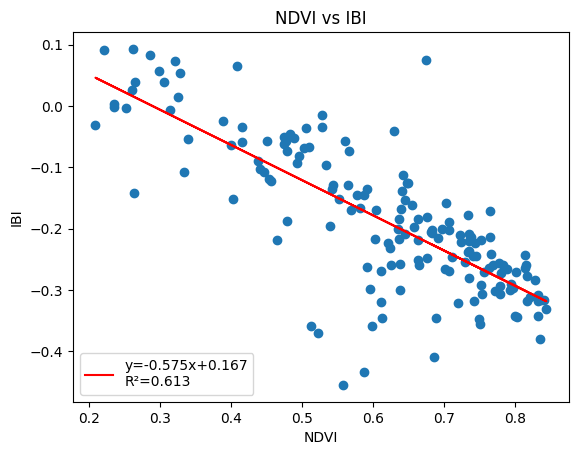

In [26]:
from scipy import stats

# NDVI vs IBI
x = dflnv['NDVI']
y = dflnv['IBI']
slope, intercept, r_value, p_value, std_err = stats.linregress(x,y)
line = slope*x+intercept

plt.scatter(x, y)
plt.plot(x, line, 'r', label='y={:.3f}x+{:.3f}\nR\u00b2={:.3f}'.format(slope,intercept, (r_value*r_value)))
plt.title('NDVI vs IBI')
plt.xlabel('NDVI')
plt.ylabel('IBI')

plt.legend(fontsize=10)

plt.show()